## RKHS

In [22]:
from lbfgsb_scipy import LBFGSBScipy
import torch
import torch.nn as nn
import numpy as np
import math
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import typing
from  torch import optim
import copy

In [23]:
torch.set_default_dtype(torch.float64)
device= torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('device:', device)
torch.set_default_device(device)

device: cuda


In [24]:
class DagmaRKHS(nn.Module):
    """n: number of samples, d: num variables"""
    def __init__(self, n, d, kernel):
        super(DagmaRKHS, self).__init__() # inherit  nn.Module
        self.d = d
        self.n = n
        self.kernel = kernel

        #self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

        #torch.manual_seed(42)

        # initialize coefficients alpha
        alpha = torch.zeros(d, n)
        self.alpha = nn.Parameter(alpha) 
        # initialize coefficients beta
        self.beta = nn.Parameter(torch.zeros(d, d, n))
        
        self.delta = torch.ones(d, d)
        self.delta.fill_diagonal_(0)
        self.I = torch.eye(self.d)#.to(self.device)
    
    
    def get_parameters(self): # [d, n]
       alpha = self.alpha
       beta = self.beta
       return alpha, beta
    
    #@timing_decorator
    @torch.no_grad()
    def gaussian_kernel_matrix_and_grad(self, x, gamma=1): 
      # x: [n, d]; K: [n, n]; grad_K1: [n, n, d]: gradient of k(x^i, x^l) wrt x^i_{k}; grad_K2: [n, n, d]: gradient of k(x^i, x^l) wrt x^l_{k}; mixed_grad: [n, n, d, d] gradient of k(x^i, x^l) wrt x^i_{a} and x^l_{b}
      #x = torch.tensor(x, requires_grad=True) 
      # Compute pairwise squared Euclidean distances using broadcasting
      diff = x.unsqueeze(1) - x.unsqueeze(0) # [n, n, d]
      #sq_dist = torch.sum(diff ** 2, dim=2)
      sq_dist = torch.einsum('jk, ilk -> jil', self.delta, diff**2) # [d, n, n]

      # Compute the Gaussian kernel matrix
      K = torch.exp(-sq_dist / (gamma ** 2)) # [d, n, n] K[j, i, l] = k(x^i, x^l) without jth coordinate
      
      # Compute the gradient of K with respect to X
      grad_K1 = -2 / (gamma ** 2) * torch.einsum('jil, ila -> jila', K, diff) # [d, n, n, d] 
      identity_mask = torch.eye(self.d, dtype=torch.bool)
      broadcastable_mask = identity_mask.view(self.d, 1, 1, self.d)
      expanded_mask = broadcastable_mask.expand(-1, self.n, self.n, -1)
      grad_K1[expanded_mask] = 0.0
      grad_K2 = -grad_K1

      outer_products_diff = torch.einsum('ila, ilb->ilab', diff, diff)  # Outer product of the differences [n, n, d, d]
      mixed_grad = (-4 / gamma**4) * torch.einsum('jil, ilab -> jilab', K, outer_products_diff) # Apply the formula for a != b [d, n, n, d, d]

      # Diagonal elements (i == j) need an additional term
      K_expanded = torch.einsum('jil,ab->jilab', K, self.I) #[d, n, n, d, d]
      mixed_grad += 2/gamma**2 * K_expanded

      expanded_identity_mask1 = identity_mask.view(self.d, 1, 1, 1, self.d).expand(self.d, self.n, self.n, self.d, self.d)
      expanded_identity_mask2 = identity_mask.view(self.d, 1, 1, self.d, 1).expand(self.d, self.n, self.n, self.d, self.d)

      # # Zero out elements in A where the mask is True
      mixed_grad[expanded_identity_mask1] = 0
      mixed_grad[expanded_identity_mask2] = 0

      return K, grad_K1, grad_K2, mixed_grad
    
    #@timing_decorator
    @torch.no_grad()
    def matern3_2_kernel_matrix_and_grad(self, x, gamma=1): # K: [n, n]; grad_K: [n, n, d]: gradient of k(x^l, x^i) wrt x^l_{a}
       #x = torch.tensor(x, requires_grad=True)
       diff = x.unsqueeze(1) - x.unsqueeze(0) #[n, n, d]
       dist = torch.sqrt(torch.sum(diff ** 2, dim=2)) #[n, n]
       K = (1 + np.sqrt(3)*dist / gamma)*torch.exp(-np.sqrt(3)*dist / gamma) #[n, n]
       temp = -3/(gamma**2)*torch.exp(-np.sqrt(3)*dist/gamma) #[n, n]
       grad_K = diff*temp.unsqueeze(2)
       #print("K: ", K.device, K.dtype)
       return K, grad_K
    
    #@timing_decorator
    @torch.no_grad()
    def matern5_2_kernel_matrix_and_grad(self, x, gamma=1): # [n, n, d]: gradient of k(x^i, x^l) wrt x^i_{k}
       #x = torch.tensor(x, requires_grad=True)
       diff = x.unsqueeze(1) - x.unsqueeze(0) #[n, n, d]
       dist = torch.sqrt(torch.sum(diff ** 2, dim=2)) #[n, n]
       K = (1 + np.sqrt(5)*dist / gamma + 5*(dist**2)/(3*(gamma**2)))*torch.exp(-np.sqrt(5)*dist / gamma)
       temp = (-5/(3*gamma**2) - 5*np.sqrt(5)*dist/(3*(gamma**3)))*torch.exp(-np.sqrt(5)*dist/gamma) #[n, n]
       grad_K = diff*temp.unsqueeze(2)
       
       return K, grad_K
    
    # @torch.no_grad()
    # def polynomial_kernel_matrix_and_grad(self, x, c=1, degree=3): # x: [n, d]; K: [n, n]; grad_K: [n, n, d]: gradient of k(x^i, x^l) wrt x^i_{k}
    #   #x = torch.tensor(x, requires_grad=True) 
    #   # Compute pairwise squared Euclidean distances using broadcasting
    #   mul = x.unsqueeze(1)*x.unsqueeze(0) # [n, n, d]

    #   # Compute the Gaussian kernel matrix
    #   K = (mul + c)**degree # [n, n]
    #   # Compute the gradient of K with respect to X
    #   grad_K = -2 * diff / (gamma ** 2) * K.unsqueeze(2) # K.unsqueeze(2): [n, n, 1]

    #   return K, grad_K
    
    #@timing_decorator
    def forward(self, x: torch.tensor): #[n, d] -> [n, d], forward(x)_{i,j} = estimation of x_j at ith observation 
      """
      x: data matrix of shape [n, d] (np.array)
      forward(x)_{l,j} = estimation of x_j at lth observation
      """
      if self.kernel == "gaussian":
        K = self.gaussian_kernel_matrix_and_grad(x)[0]
        #grad_K1 = self.gaussian_kernel_matrix_and_grad(x)[1]
        grad_K2 = self.gaussian_kernel_matrix_and_grad(x)[2]
      elif self.kernel == "matern3_2":
        K = self.matern3_2_kernel_matrix_and_grad(x)[0]
        grad_K2 = self.matern3_2_kernel_matrix_and_grad(x)[2]
      elif self.kernel == "matern5_2":
        K = self.matern5_2_kernel_matrix_and_grad(x)[0]
        grad_K2 = self.matern5_2_kernel_matrix_and_grad(x)[2]
      else:
        print("Given kernel is invalid.")
      beta = self.get_parameters()[1]  
      output1 = torch.einsum('jl, jil -> ij', self.alpha, K) # [n, d]
      output2 = torch.einsum('jal, jila -> ijl', beta, grad_K2) # [n, d, n]
      output2 = torch.sum(output2, dim = 2) # [n, d]
      output = output1 + output2 # [n, d]
      return output
      #return output1, output2


    #@timing_decorator
    def fc1_to_adj(self, x: torch.tensor) -> torch.Tensor: # [d, d]
      if self.kernel == "gaussian":
        grad_K1 = self.gaussian_kernel_matrix_and_grad(x)[1] # [n, n, d]
        mixed_grad = self.gaussian_kernel_matrix_and_grad(x)[3] # [n, n, d, d]
      elif self.kernel == "matern3_2":
        grad_K1 = self.matern3_2_kernel_matrix_and_grad(x)[1]
      elif self.kernel == "matern5_2":
        grad_K1 = self.matern5_2_kernel_matrix_and_grad(x)[1]
      else:
        print("Given kernel is invalid.")

      weight1 = torch.einsum('jl, jilk -> kij', self.alpha, grad_K1) # [d, n, d]
      beta = self.get_parameters()[1]  
      weight2 = torch.einsum('jal, jilka -> kij', beta, mixed_grad) # [d, n, d]
      weight = weight1 + weight2
      weight = torch.sum(weight ** 2, dim = 1)/self.n # [d, d]

      #return weight1, weight2, weight
      return weight
    
    #@timing_decorator
    #expoential h
    # def h_func(self, x: torch.tensor):
    #   weight = self.fc1_to_adj(x)
    #   h = trace_expm(weight)-self.d
    #   return h
    
    # log determinant h
    def h_func(self, x: torch.tensor, s: torch.tensor):
      s = torch.tensor(s, dtype=torch.float64)
      weight = self.fc1_to_adj(x)
      #print("weight:", weight)
      A = s*self.I - weight
      sign, logabsdet = torch.linalg.slogdet(A)
      #print("t type: ", t.dtype)
      h = -logabsdet + self.d * torch.log(s)
      #print("h: ", h)
      return h

    #spetrum h
    # def h_func(self, x: torch.tensor):
    #   weight = self.fc1_to_adj(x)
    #   w = torch.ones(self.d)
    #   for _ in range(10):
    #       w = weight @ w
    #       w = w / (torch.norm(w) + 1e-8)
    #   return w @ weight @ w
    

    #@timing_decorator
    def L_risk(self, x: torch.tensor, lambda1, tau): # [1, 1]
      """compute the regularized iempirical L_risk of squared loss function, penalty: penalty for H_norm"""
      if self.kernel == "gaussian":
          K = self.gaussian_kernel_matrix_and_grad(x)[0] # [n, n]
          mixed_grad = self.gaussian_kernel_matrix_and_grad(x)[3] # [n, n, d, d]
          K_grad2 = self.gaussian_kernel_matrix_and_grad(x)[2] # [n, n, d]
      elif self.kernel == "matern3_2":
          K = self.matern3_2_kernel_matrix_and_grad(x)[0] # [n, n]
      elif self.kernel == "matern5_2":
          K = self.matern5_2_kernel_matrix_and_grad(x)[0] # [n, n]
      else:
          print("Given kernel is invalid.") 
      beta = self.get_parameters()[1]  
      x_est = self.forward(x) # [n, d]
      squared_loss = 0.5 / self.n * torch.sum((x_est - x) ** 2)
      # temp = torch.matmul(torch.matmul(self.alpha, K), self.alpha.t())
      # diagonal = torch.sum(torch.diag(temp))
      temp1 = torch.einsum('ji, jil -> jl', self.alpha, K) #[d, n]
      temp1 = (self.alpha*temp1).sum() 
      temp2 = torch.einsum('jal, jila -> ji', beta, K_grad2) #[d, n]
      temp2 = (self.alpha * temp2).sum()
      temp3 = torch.einsum('jbl, jilab -> jai', beta, mixed_grad) #[d, d, n]
      temp3 = (beta * temp3).sum()
      regularized = lambda1*(temp1 + temp2 + temp3)
      W = self.fc1_to_adj(x)
      help = torch.tensor(1e-8) # numerical stability
      W_sqrt = torch.sqrt(W+help)
      sparsity = torch.sum(W_sqrt)
      loss = squared_loss + tau*(regularized + 2*sparsity)
      return loss
      #return temp2, temp3

In [25]:
import torch
print(torch.__version__) #current version
print(torch.cuda.is_available()) #check if GPU is available


2.1.0+cu118
True


In [26]:
class DagmaRKHS_nonlinear:
    """
    Class that implements the DAGMA algorithm
    """

    def __init__(self, model: nn.Module, verbose: bool = False, dtype: torch.dtype = torch.float64):
        """
        Parameters
        ----------
        model : nn.Module
            Neural net that models the structural equations.
        verbose : bool, optional
            If true, the loss/score and h values will print to stdout every ``checkpoint`` iterations,
            as defined in :py:meth:`~dagma.nonlinear.DagmaNonlinear.fit`. Defaults to ``False``.
        dtype : torch.dtype, optional
            float number precision, by default ``torch.double``.
        """
        self.vprint = print if verbose else lambda *a, **k: None
        #self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        self.model = model#.to(self.device)

        self.dtype = dtype

        
    def minimize(self, 
                max_iter: float, 
                lr: float, 
                lambda1: float, 
                tau: float,
                lambda2: float, 
                mu: float, 
                s: float,
                lr_decay: float = False, 
                tol: float = 1e-6, 
                pbar: typing.Optional[tqdm] = None,
        ) -> bool:
        r"""
        Solves the optimization problem: 
            .. math::
                \arg\min_{W(\Theta) \in \mathbb{W}^s} \mu \cdot Q(\Theta; \mathbf{X}) + h(W(\Theta)),
        where :math:`Q` is the score function, and :math:`W(\Theta)` is the induced weighted adjacency matrix
        from the model parameters. 
        This problem is solved via (sub)gradient descent using adam acceleration.

        Parameters
        ----------
        max_iter : float
            Maximum number of (sub)gradient iterations.
        lr : float
            Learning rate.
        lambda1 : float
            function penalty coefficient. 
        tau : float
            sparsity penalty coefficient.
        lambda2 : float
            L2 penalty coefficient. Applies to all the model parameters.
        mu : float
            Weights the score function.
        s : float
            Controls the domain of M-matrices.
        lr_decay : float, optional
            If ``True``, an exponential decay scheduling is used. By default ``False``.
        tol : float, optional
            Tolerance to admit convergence. Defaults to 1e-6.
        pbar : tqdm, optional
            Controls bar progress. Defaults to ``tqdm()``.

        Returns
        -------
        bool
            ``True`` if the optimization succeded. This can be ``False`` when at any iteration, the model's adjacency matrix 
            got outside of the domain of M-matrices.
        """
        self.vprint(f'\nMinimize s={s} -- lr={lr}')

        # for param in self.model.parameters():
        #     print('param.device',param.device, param.dtype)


        optimizer = optim.Adam(self.model.parameters(), lr=lr, betas=(.99,.999), weight_decay=mu*lambda2)
        if lr_decay is True:
            scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.8)
        obj_prev = 1e16
        for i in range(max_iter):
            optimizer.zero_grad()
            h_val = self.model.h_func(self.X, s)
            #print("h_val: ", h_val.device, h_val.dtype)
            if h_val.item() < 0:
                self.vprint(f'Found h negative {h_val.item()} at iter {i}')
                return False
            score = self.model.L_risk(self.X, lambda1, tau)
            print("squared loss: ", score)
            print("mu: ", mu)
            print("h_val: ", h_val)
            obj = mu * score + h_val
            print("obj: ", obj)
            obj.backward()
            optimizer.step()
            if lr_decay and (i+1) % 1000 == 0: #every 1000 iters reduce lr
                scheduler.step()
            if i % self.checkpoint == 0 or i == max_iter-1:
                obj_new = obj.item()
                self.vprint(f"\nInner iteration {i}")
                self.vprint(f'\th(W(model)): {h_val.item()}')
                self.vprint(f'\tscore(model): {obj_new}')
                if np.abs((obj_prev - obj_new) / obj_prev) <= tol:
                    pbar.update(max_iter-i)
                    break
                obj_prev = obj_new
            pbar.update(1)
        return True
    

    def fit(self, 
        X: torch.Tensor,
        lambda1: torch.float64 = .02, 
        tau: torch.float64 = .02,
        lambda2: torch.float64 = .005,
        T: torch.int = 4, 
        mu_init: torch.float64 = 0.1, 
        mu_factor: torch.float64 = .1, 
        s: torch.float64 = 1.0,
        warm_iter: torch.int = 5e3, 
        max_iter: torch.int = 8e3, 
        lr: torch.float64 = .005, 
        w_threshold: torch.float64 = 0.3, 
        checkpoint: torch.int = 1000,
    ) -> np.ndarray:
        r"""
        Runs the DAGMA algorithm and fits the model to the dataset.

        Parameters
        ----------
        X : typing.Union[torch.Tensor, np.ndarray]
            :math:`(n,d)` dataset.
        lambda1 : float, optional
            Coefficient of the function penalty, by default .02.
        lambda2 : float, optional
            Coefficient of the L2 penalty, by default .005.
        T : int, optional
            Number of DAGMA iterations, by default 4.
        mu_init : float, optional
            Initial value of :math:`\mu`, by default 0.1.
        mu_factor : float, optional
            Decay factor for :math:`\mu`, by default .1.
        s : float, optional
            Controls the domain of M-matrices, by default 1.0.
        warm_iter : int, optional
            Number of iterations for :py:meth:`~dagma.nonlinear.DagmaNonlinear.minimize` for :math:`t < T`, by default 5e3.
        max_iter : int, optional
            Number of iterations for :py:meth:`~dagma.nonlinear.DagmaNonlinear.minimize` for :math:`t = T`, by default 8e3.
        lr : float, optional
            Learning rate, by default .0002.
        w_threshold : float, optional
            Removes edges with weight value less than the given threshold, by default 0.3.
        checkpoint : int, optional
            If ``verbose`` is ``True``, then prints to stdout every ``checkpoint`` iterations, by default 1000.

        Returns
        -------
        np.ndarray
            Estimated DAG from data.
        
        
        .. important::

            If the output of :py:meth:`~dagma.nonlinear.DagmaNonlinear.fit` is not a DAG, then the user should try larger values of ``T`` (e.g., 6, 7, or 8) 
            before raising an issue in github.
        """
        torch.set_default_dtype(self.dtype)
        self.X = X
        self.checkpoint = checkpoint
        mu = mu_init
        if type(s) == list:
            if len(s) < T: 
                self.vprint(f"Length of s is {len(s)}, using last value in s for iteration t >= {len(s)}")
                s = s + (T - len(s)) * [s[-1]]
        elif type(s) in [int, float]:
            s = T * [s]
        else:
            ValueError("s should be a list, int, or float.") 

        with tqdm(total=(T-1)*warm_iter+max_iter) as pbar:
            for i in range(int(T)):
                self.vprint(f'\nDagma iter t={i+1} -- mu: {mu}', 30*'-')
                success, s_cur = False, s[i]
                inner_iter = int(max_iter) if i == T - 1 else int(warm_iter)
                model_copy = copy.deepcopy(self.model)
                lr_decay = False
                while success is False:
                    success = self.minimize(inner_iter, lr, lambda1, tau, lambda2, mu, s_cur, 
                                        lr_decay, pbar=pbar)
                    if success is False:
                        self.model.load_state_dict(model_copy.state_dict().copy()) # restore the model parameters to last iteration
                        # reset lr, lr_decay, s_cur then update the model
                        lr *= 0.5 
                        lr_decay = True
                        if lr < 1e-10:
                            print(":(")
                            break # lr is too small
                        s_cur = 1
                mu *= mu_factor
        W_est = self.model.fc1_to_adj(self.X)
        W_est = torch.sqrt(W_est)
        W_est = W_est.cpu().detach().numpy()
        print(W_est)
        W_est[np.abs(W_est) < w_threshold] = 0
        output = self.model.forward(self.X)
        return W_est, output

## Test

### Set up

In [18]:
def gaussian_kernel(x, y, gamma=1): # [d, 1] * [d, 1] -> [1, 1]
    #distance_squared = torch.norm(x-y, dim=1, keepdim=True)**2
    distance_squared = torch.norm(x-y, dim=-1)**2
    return torch.exp(-distance_squared / (gamma**2))

### kernel

In [101]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
K1 = instance.gaussian_kernel_matrix_and_grad(x)[0]
K2 = torch.zeros(2,2)
for i in range(2):
    for j in range(2):
        K2[i,j] = gaussian_kernel(x[i, :], x[j, :], gamma=1)
print("K1: ", K1)
print("K2: ", K2)

K1:  tensor([[1.0000e+00, 1.7139e-15],
        [1.7139e-15, 1.0000e+00]])
K2:  tensor([[1.0000e+00, 1.7139e-15],
        [1.7139e-15, 1.0000e+00]], grad_fn=<CopySlices>)


### mixed_grad operator

In [84]:
x = np.array([[1, 2, 3], [4, 5, 7]])
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
diff = x.unsqueeze(1) - x.unsqueeze(0)
print(diff)
print(diff[0,1])

tensor([[[ 0.,  0.,  0.],
         [-3., -3., -4.]],

        [[ 3.,  3.,  4.],
         [ 0.,  0.,  0.]]], grad_fn=<SubBackward0>)
tensor([-3., -3., -4.], grad_fn=<SelectBackward0>)


In [87]:
outer_products = torch.einsum('ijl,ijk->ijlk', diff, diff)
print(outer_products)
print(outer_products.shape)

tensor([[[[ 0.,  0.,  0.],
          [ 0.,  0.,  0.],
          [ 0.,  0.,  0.]],

         [[ 9.,  9., 12.],
          [ 9.,  9., 12.],
          [12., 12., 16.]]],


        [[[ 9.,  9., 12.],
          [ 9.,  9., 12.],
          [12., 12., 16.]],

         [[ 0.,  0.,  0.],
          [ 0.,  0.,  0.],
          [ 0.,  0.,  0.]]]], grad_fn=<MulBackward0>)
torch.Size([2, 2, 3, 3])


In [91]:
K = torch.randint(low=0, high=10, size=(2, 2))
print("K", K)
K = K.view(2, 2, 1, 1)
print(K*outer_products)

K tensor([[5, 9],
        [1, 5]])
tensor([[[[  0.,   0.,   0.],
          [  0.,   0.,   0.],
          [  0.,   0.,   0.]],

         [[ 81.,  81., 108.],
          [ 81.,  81., 108.],
          [108., 108., 144.]]],


        [[[  9.,   9.,  12.],
          [  9.,   9.,  12.],
          [ 12.,  12.,  16.]],

         [[  0.,   0.,   0.],
          [  0.,   0.,   0.],
          [  0.,   0.,   0.]]]], grad_fn=<MulBackward0>)


In [97]:
output = torch.randint(low=0, high=10, size=(2, 2, 3, 3))
d = 3
K = torch.randint(low=0, high=10, size=(2, 2))
print("output:", output)
print("K: ", K)
I = torch.eye(d, d)
K_expanded = torch.einsum('ij,kl->ijkl', K, I)
result = output + K_expanded
print("result: ", result)

output: tensor([[[[7, 3, 5],
          [2, 1, 0],
          [9, 3, 1]],

         [[1, 0, 3],
          [6, 6, 7],
          [9, 6, 3]]],


        [[[4, 5, 0],
          [8, 2, 8],
          [2, 7, 5]],

         [[0, 0, 8],
          [1, 9, 6],
          [1, 0, 2]]]])
K:  tensor([[9, 4],
        [3, 9]])
result:  tensor([[[[16.,  3.,  5.],
          [ 2., 10.,  0.],
          [ 9.,  3., 10.]],

         [[ 5.,  0.,  3.],
          [ 6., 10.,  7.],
          [ 9.,  6.,  7.]]],


        [[[ 7.,  5.,  0.],
          [ 8.,  5.,  8.],
          [ 2.,  7.,  8.]],

         [[ 9.,  0.,  8.],
          [ 1., 18.,  6.],
          [ 1.,  0., 11.]]]])


### forward

In [102]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
n = 2
d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
forward1 = instance.forward(x)[0]
forward2 = instance.forward(x)[1]

# compute K and output1
alpha = instance.get_parameters()[0]
beta = instance.get_parameters()[1]
K = torch.zeros(2, 2)
output1 = torch.zeros(2, 3)
for i in range(2):
      for l in range(2):
            K[i,l] = gaussian_kernel(x[i,:], x[l,:], gamma=1)
for i in range(2):
      for j in range(3):
            for l in range(2):
                  output1[i, j] += K[i,l] * alpha[j, l]

# compute grad_K
def grad_kernel(x) -> torch.Tensor: # [n, n, d] grad_storage[i, l, k]: gradient of k(x^i, x^l) wrt x^l_{k}
      #Get W from fc1 weights, take L2 norm of the gradient
      # get [n, n, d] gradient matrix of the kernel
      # Initialize a tensor to store gradients
      grad_K2 = torch.zeros(n, n, d)
      # Compute gradients
      for i in range(n):
         for l in range(n):
            x_i = x[i,:]
            x_l = x[l,:]
            x_l.retain_grad()
            K_il = gaussian_kernel(x_i, x_l, gamma=1)
            # Zero out gradients in x, otherwise it accumulate the gradients
            if x_l.grad is not None:
                  x_l.grad.zero_()
            # Select individual scalar element from y
            # Perform backward pass on the scalar element
            K_il.backward()
            # Store the computed gradients
            grad_K2[i, l] = x_l.grad.clone() 
      return grad_K2

grad_K2 = grad_kernel(x)

# compute output2
output2 = torch.zeros(3, 2)

for j in range(d):
     for i in range(n):
          for l in range(n):
               temp = 0
               for a in range(d):
                    temp += beta[j, a, l]*grad_K2[i, l, a]
               output2[j, i] += temp
output2 = output2.t()
output = output1 + output2

# compare
print("forward1: ", forward1)
print("forward2: ", forward2)
#print("output: ", output)
print("output1: ", output1)
print("output2: ", output2)

forward1:  tensor([[-0.6249, -0.5323,  0.0370],
        [-0.6181, -0.6327, -0.0328]], grad_fn=<MmBackward0>)
forward2:  tensor([[ 2.5632e-14, -2.0809e-15, -1.8223e-15],
        [-4.1935e-14,  5.2732e-15, -1.2527e-14]], grad_fn=<TBackward0>)
output1:  tensor([[-0.6249, -0.5323,  0.0370],
        [-0.6181, -0.6327, -0.0328]], grad_fn=<CopySlices>)
output2:  tensor([[ 2.5632e-14, -2.0809e-15, -1.8223e-15],
        [-4.1935e-14,  5.2732e-15, -1.2527e-14]], grad_fn=<TBackward0>)


### L_risk

In [188]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
n = 2
d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")

# forward = instance.forward(x)
# squared_loss = 0
# for j in range(3):
#     for i in range(2):
#         squared_loss += (x[i, j] - forward[i, j])**2
# squared_loss = squared_loss/(2*2)

# K = torch.zeros(2, 2)
# output = torch.zeros(2, 3)
# for i in range(2):
#       for l in range(2):
#             K[i,l] = gaussian_kernel(x[i,:], x[l,:], gamma=1)
K = instance.gaussian_kernel_matrix_and_grad(x)[0]
K_grad2 = instance.gaussian_kernel_matrix_and_grad(x)[2]
mixed_grad = instance.gaussian_kernel_matrix_and_grad(x)[3]
regularized1 = 0
alpha = instance.get_parameters()[0]
beta = instance.get_parameters()[1]
for j in range(3):
    for m in range(2):
        for l in range(2):
            regularized1 += alpha[j, m]*alpha[j, l]* K[m, l]

temp = torch.zeros((d, n)) # [j, i]
for j in range(d):
    for i in range(n):
        for l in range(n):
            for a in range(d):
                temp[j, i] += beta[j, a, l]*K_grad2[i, l, a]
regularized2 = 0
for j in range(d):
        for i in range(n):
            regularized2 += alpha[j, i] * temp[j, i]

temp2 = torch.zeros((d, d, n)) # [j, a, i]

regularized3 = 0
for j in range(d):
    for a in range(d):
        for i in range(n):
            for l in range(n):
                for b in range(d):
                    temp2[j, a, i] += beta[j, b, l]*mixed_grad[i, l, a, b]

for j in range(d):
    for a in range(d):
        for i in range(n):
            regularized3 += beta[j, a, i] * temp2[j, a, i]


# regularized = regularized1 + regularized2

# lambda1 = 0.01
# regularized = lambda1*regularized
#loss = squared_loss + regularized
print("regularized2", regularized2)
print("regularized3", regularized3)
L_risk = instance.L_risk(x, lambda1=0.01)
print("temp2", L_risk[0])
print("temp3", L_risk[1])

regularized2 tensor(8.0200e-15, grad_fn=<AddBackward0>)
regularized3 tensor(28.2388, grad_fn=<AddBackward0>)
temp2 tensor(8.0200e-15, grad_fn=<SumBackward0>)
temp3 tensor(28.2388, grad_fn=<SumBackward0>)


### grad_K

In [169]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
grad_K1 = instance.gaussian_kernel_matrix_and_grad(x)[1]

n = 2
d = 3
def grad_kernel(x) -> torch.Tensor: # [n, n, d] grad_storage[i, l, k]: gradient of k(x^i, x^l) wrt x^l_{k}
      #Get W from fc1 weights, take L2 norm of the gradient
      # get [n, n, d] gradient matrix of the kernel
      # Initialize a tensor to store gradients
      grad_K = torch.zeros(n, n, d)
      # Compute gradients
      for i in range(n):
         for l in range(n):
            x_i = x[i,:]
            x_l = x[l,:]
            x_i.retain_grad()
            K_il = gaussian_kernel(x_i, x_l, gamma=1)
            # Zero out gradients in x, otherwise it accumulate the gradients
            if x_i.grad is not None:
                  x_i.grad.zero_()
            # Select individual scalar element from y
            # Perform backward pass on the scalar element
            K_il.backward()
            # Store the computed gradients
            grad_K[i, l] = x_i.grad.clone() 
      return grad_K

grad_K2 = grad_kernel(x)

print("grad_K1: ", grad_K1)
print("grad_K2: ", grad_K2)
print(torch.equal(grad_K1, grad_K2))


grad_K1:  tensor([[[-0.0000e+00, -0.0000e+00, -0.0000e+00],
         [ 1.0283e-14,  1.0283e-14,  1.3711e-14]],

        [[-1.0283e-14, -1.0283e-14, -1.3711e-14],
         [-0.0000e+00, -0.0000e+00, -0.0000e+00]]])
grad_K2:  tensor([[[-0.0000e+00, -0.0000e+00, -0.0000e+00],
         [ 1.0283e-14,  1.0283e-14,  1.3711e-14]],

        [[-1.0283e-14, -1.0283e-14, -1.3711e-14],
         [-0.0000e+00, -0.0000e+00, -0.0000e+00]]])
False


In [170]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")

mixed_partials = torch.zeros(n, n, d, d)

# Compute the mixed partial derivatives for each sample
for i in range(n):
    for l in range(n):
        x_i = x[i,:]
        x_l = x[l,:]
        #x_i.retain_grad()
        #x_l.retain_grad()
        K_il = gaussian_kernel(x_i, x_l, gamma=1)
        #K_il = f(x_i, x_l)
        if grads_x is not None:
            grads_x.zero_()
        grads_x = torch.autograd.grad(K_il, x_i, create_graph=True, retain_graph=True)[0]
        print(grads_x)
        for a in range(d):
            for b in range(d):
                mixed_partials[i,l,a,b]=torch.autograd.grad(grads_x[a], x_l, retain_graph=True)[0][b]

# Detach the mixed partial derivatives tensor from the graph for further use
mixed_partials = mixed_partials.detach()

print("Mixed partial derivatives for each sample and each pair of dimensions:")
print(mixed_partials)

mixed_grad = instance.gaussian_kernel_matrix_and_grad(x)[3]
print("mixed_grad: ", mixed_grad )

tensor([-0., -0., -0.], grad_fn=<MulBackward0>)
tensor([1.0283e-14, 1.0283e-14, 1.3711e-14], grad_fn=<MulBackward0>)
tensor([-1.0283e-14, -1.0283e-14, -1.3711e-14], grad_fn=<MulBackward0>)
tensor([-0., -0., -0.], grad_fn=<MulBackward0>)
Mixed partial derivatives for each sample and each pair of dimensions:
tensor([[[[        nan,         nan,         nan],
          [        nan,         nan,         nan],
          [        nan,         nan,         nan]],

         [[-5.8273e-14, -6.1701e-14, -8.2268e-14],
          [-6.1701e-14, -5.8273e-14, -8.2268e-14],
          [-8.2268e-14, -8.2268e-14, -1.0626e-13]]],


        [[[-5.8273e-14, -6.1701e-14, -8.2268e-14],
          [-6.1701e-14, -5.8273e-14, -8.2268e-14],
          [-8.2268e-14, -8.2268e-14, -1.0626e-13]],

         [[        nan,         nan,         nan],
          [        nan,         nan,         nan],
          [        nan,         nan,         nan]]]])
mixed_grad:  tensor([[[[ 2.0000e+00,  0.0000e+00,  0.0000e+00],
     

In [117]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
mixed_partials = torch.zeros(n, n, d, d)
n = 2
d = 3
for k in range(0, n):
    for l in range(0, n):
       x_k = x[k, :]
       x_l = x[l, :]
       K_kl = gaussian_kernel(x_k, x_l, gamma=1)
       for i in range(d):
           for j in range(d):
                mixed_partials[k,l,i,j] = -K_kl*(x_k[j] - x_l[j])*(x_k[i] - x_l[i])
                if i == j:
                    mixed_partials[k,l,i,j] += K_kl
print("mixed_partials", mixed_partials)

mixed_partials tensor([[[[ 1.0000e+00, -0.0000e+00, -0.0000e+00],
          [-0.0000e+00,  1.0000e+00, -0.0000e+00],
          [-0.0000e+00, -0.0000e+00,  1.0000e+00]],

         [[-1.3711e-14, -1.5425e-14, -2.0567e-14],
          [-1.5425e-14, -1.3711e-14, -2.0567e-14],
          [-2.0567e-14, -2.0567e-14, -2.5709e-14]]],


        [[[-1.3711e-14, -1.5425e-14, -2.0567e-14],
          [-1.5425e-14, -1.3711e-14, -2.0567e-14],
          [-2.0567e-14, -2.0567e-14, -2.5709e-14]],

         [[ 1.0000e+00, -0.0000e+00, -0.0000e+00],
          [-0.0000e+00,  1.0000e+00, -0.0000e+00],
          [-0.0000e+00, -0.0000e+00,  1.0000e+00]]]], grad_fn=<CopySlices>)


In [72]:
# small example for partial derivative
torch.manual_seed(0)
# Example function f(x, y)
def f(x, y):
    # This is a placeholder for your actual function
    return (x ** 2).sum() * (y ** 2).sum()

# Dimensions of the vectors
d = 3

# x = torch.rand(d, requires_grad=True)
# y = torch.rand(d, requires_grad=True)
x = np.array([1, 2, 3]) 
y = np.array([4, 5, 7])

x = torch.tensor(x, dtype=torch.float32, requires_grad=True)
y = torch.tensor(y, dtype=torch.float32, requires_grad=True)

# Initialize the gradient matrix
grad = torch.zeros((d, d))

# Compute f(x, y)
output = f(x, y)

grads_x = torch.autograd.grad(output, x, create_graph=True, retain_graph=True)[0]
print("grads_x: ", grads_x)

# Initialize the gradient matrix for the mixed partial derivatives
grad = torch.zeros((d, d))

for i in range(d):
    # For each component in grads_x, compute its gradient with respect to y
    for j in range(d):
        grad[i, j] = torch.autograd.grad(grads_x[i], y, retain_graph=True)[0][j]

print("x: ", x)
print("y: ", y)
print("Mixed partial gradient matrix: \n", grad)
        


grads_x:  tensor([180., 360., 540.], dtype=torch.float32, grad_fn=<MulBackward0>)
x:  tensor([1., 2., 3.], dtype=torch.float32, requires_grad=True)
y:  tensor([4., 5., 7.], dtype=torch.float32, requires_grad=True)
Mixed partial gradient matrix: 
 tensor([[16., 20., 28.],
        [32., 40., 56.],
        [48., 60., 84.]])


### fc1_to_adj(x)

In [144]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
n = 2
d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
W1 = instance.fc1_to_adj(x)[0]
W2 = instance.fc1_to_adj(x)[1]
W3 = instance.fc1_to_adj(x)[2]

alpha = instance.get_parameters()[0]
beta  = instance.get_parameters()[1]
weight = torch.zeros(d, d)
weight1 = torch.zeros(d, n, d)
weight2 = torch.zeros(d, n, d)
grad_K1 = instance.gaussian_kernel_matrix_and_grad(x)[1]
mixed_grad = instance.gaussian_kernel_matrix_and_grad(x)[3]

for k in range(d):
    for j in range(d):
        for i in range(n):
            temp = 0
            for l in range(n):
                temp += alpha[j, l]*grad_K1[i, l, k]
            weight1[k, i, j] = temp
#weight1 = weight1.permute(2,1,0)

for k in range(d):
    for j in range(d):
        for i in range(n):
            for l in range(n):
                temp = 0
                for a in range(d):
                    temp += beta[j, a, l]*mixed_grad[i, l, k, a]
                weight2[k,i,j] += temp
#weight2 = weight2.permute(2,1,0)

for k in range(d):
    for j in range(d):
        for i in range(n):
            weight[k, j] = weight[k,j] + ((weight1[k,i,j] + weight2[k,i,j])**2)
weight = weight/n

print("W1: ", W1)
print("W2: ", W2)
print("W3: ", W3)
print("weight1: ", weight1)
print("weight2: ", weight2)
print("weight: ", weight)

W1:  tensor([[[-6.3566e-15, -6.5068e-15, -3.3762e-16],
         [ 6.4258e-15,  5.4742e-15, -3.8062e-16]],

        [[-6.3566e-15, -6.5068e-15, -3.3762e-16],
         [ 6.4258e-15,  5.4742e-15, -3.8062e-16]],

        [[-8.4755e-15, -8.6758e-15, -4.5016e-16],
         [ 8.5677e-15,  7.2989e-15, -5.0749e-16]]], grad_fn=<ViewBackward0>)
W2:  tensor([[[-3.5806,  0.9146, -3.0531],
         [-3.4968,  1.0354, -0.6623]],

        [[ 0.0769, -0.5541, -1.2756],
         [-0.2365, -1.3283,  0.2144]],

        [[-3.4891,  0.4988,  1.4192],
         [-0.9389,  0.5232,  0.6017]]], grad_fn=<ViewBackward0>)
W3:  tensor([[12.5242,  0.9543,  4.8800],
        [ 0.0309,  1.0357,  0.8365],
        [ 6.5277,  0.2613,  1.1881]], grad_fn=<DivBackward0>)
weight1:  tensor([[[-6.3566e-15, -6.5068e-15, -3.3762e-16],
         [ 6.4258e-15,  5.4742e-15, -3.8062e-16]],

        [[-6.3566e-15, -6.5068e-15, -3.3762e-16],
         [ 6.4258e-15,  5.4742e-15, -3.8062e-16]],

        [[-8.4755e-15, -8.6758e-15, -4.5016e-

### kernel_matrix_and_grad

In [ ]:
x = np.array([[1, 2, 3], [4, 5, 7]])
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
instance.gaussian_kernel_matrix_and_grad(x)[1]

tensor([[[-0.0000, -0.0000, -0.0000],
         [ 0.0427,  0.0427,  0.0569]],

        [[-0.0427, -0.0427, -0.0569],
         [-0.0000, -0.0000, -0.0000]]], grad_fn=<MulBackward0>)

In [ ]:
n = 2
d = 3
def grad_kernel(x) -> torch.Tensor: # [n, n, d] grad_storage[i, l, k]: gradient of k(x^i, x^l) wrt x^l_{k}
      #Get W from fc1 weights, take L2 norm of the gradient
      # get [n, n, d] gradient matrix of the kernel
      # Initialize a tensor to store gradients
      x = torch.tensor(x, dtype=torch.float32, requires_grad=True)
      grad_K = torch.zeros(n, n, d)
      # Compute gradients
      for i in range(n):
         for l in range(n):
            x_i = x[i,:]
            x_l = x[l,:]
            x_i.retain_grad()
            K_il = gaussian_kernel(x_i, x_l, gamma=1)
            # Zero out gradients in x, otherwise it accumulate the gradients
            if x_i.grad is not None:
                  x_i.grad.zero_()
            # Select individual scalar element from y
            # Perform backward pass on the scalar element
            K_il.backward()
            # Store the computed gradients
            grad_K[i, l] = x_i.grad.clone() 
      return grad_K

grad_kernel(x)

C:\Users\yurou\AppData\Local\Temp\ipykernel_6360\2157853284.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  x = torch.tensor(x, dtype=torch.float32, requires_grad=True)


tensor([[[-0.0000, -0.0000, -0.0000],
         [ 0.0427,  0.0427,  0.0569]],

        [[-0.0427, -0.0427, -0.0569],
         [-0.0000, -0.0000, -0.0000]]])

### h_function

## Toy example

### exponential h

In [27]:
np.random.seed(2)
x = np.random.uniform(low=0, high=10, size=100)



epsilon = np.random.normal(0,1, 100) 

y = [x**2 + epsilon for x, epsilon in zip(x, epsilon)]

y = np.array(y)  # your y data here

X = np.column_stack((x, y))

n = X.shape[0]
d = X.shape[1]
X = torch.tensor(X, dtype=torch.float64)

eq_model = DagmaRKHS(n, d, "gaussian")
eq_model.to(device)

model = DagmaRKHS_nonlinear(eq_model)
W_est, output = model.fit(X, lambda1=0.01, tau=0.01)
print(W_est)

  0%|          | 0/23000.0 [00:00<?, ?it/s]

squared loss:  tensor(785.4161, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0., device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(78.5416, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(782.5073, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(1.0236e-05, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(78.2507, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(779.6142, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0002, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(77.9616, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(776.7367, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0007, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(77.6744, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(773.8752, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0020, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(77.38

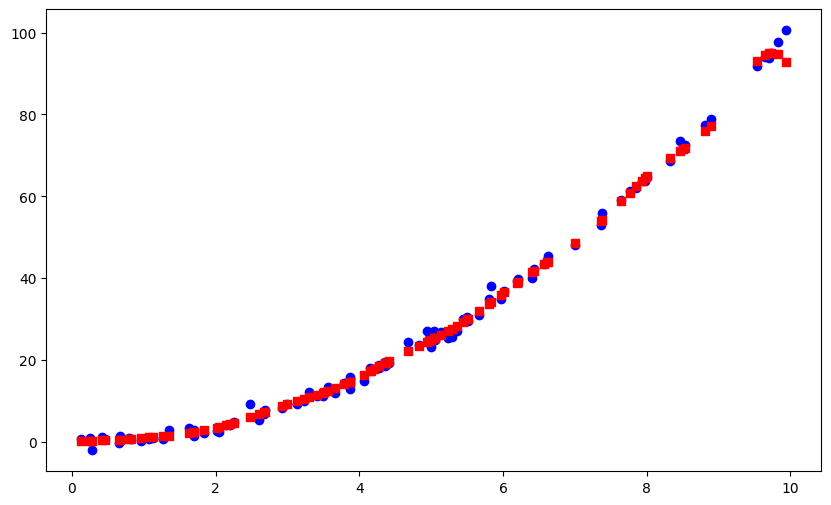

In [21]:
import matplotlib.pyplot as plt

y_hat = output[:, 1].cpu().detach().numpy()
plt.figure(figsize=(10, 6))  # Optional: specifies the figure size
plt.scatter(x, y, label='y1', color='blue', marker='o')  # Plot x vs. y1
plt.scatter(x, y_hat, label='y2', color='red', marker='s') 

In [13]:
np.random.seed(8)

x = np.random.uniform(low=0.001, high=1, size=100)

epsilon = np.random.normal(0,1, 100) 

y = [1/x + epsilon for x, epsilon in zip(x, epsilon)]

X = np.column_stack((x, y))

n = X.shape[0]
d = X.shape[1]

X = torch.tensor(X, dtype=torch.float64)
eq_model = DagmaRKHS(n, d, "gaussian")
eq_model.to(device)

model = DagmaRKHS_nonlinear(eq_model)
W_est, output = model.fit(X, lambda1=0.01, tau=0.01)
print(W_est)

  0%|          | 0/23000.0 [00:00<?, ?it/s]

squared loss:  tensor(160.3964, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0., device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(16.0396, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(156.2778, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0212, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(15.6490, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(152.5493, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0080, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(15.2630, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(149.1314, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.1375, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(15.0507, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(146.0345, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0364, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(14.6398, 

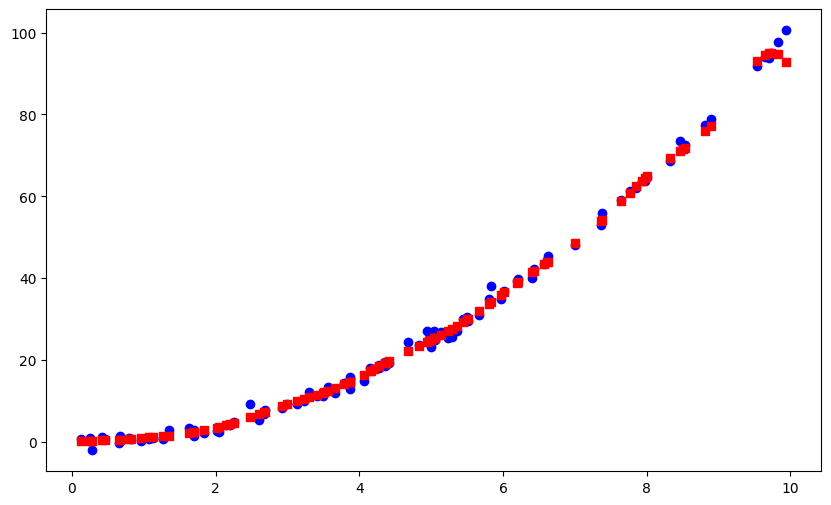

In [28]:
y_hat = output[:, 1].cpu().detach().numpy()
plt.figure(figsize=(10, 6))  # Optional: specifies the figure size
plt.scatter(x, y, label='y1', color='blue', marker='o')  # Plot x vs. y1
plt.scatter(x, y_hat, label='y2', color='red', marker='s') 

In [29]:
np.random.seed(1)
x = np.random.uniform(low=-5, high=5, size=100)

epsilon = np.random.normal(0,1, 100) 


y = [x**3 + x + epsilon for x, epsilon in zip(x, epsilon)]

y = np.array(y)  
X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]

X = torch.tensor(X, dtype=torch.float64)
eq_model = DagmaRKHS(n, d, "gaussian")
eq_model.to(device)

model = DagmaRKHS_nonlinear(eq_model)
W_est, output = model.fit(X, lambda1=0.01, tau=0.01)
print(W_est)

  0%|          | 0/23000.0 [00:00<?, ?it/s]

squared loss:  tensor(1341.0252, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0., device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(134.1025, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(1336.6676, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(4.8079e-06, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(133.6668, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(1332.3221, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(7.5661e-05, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(133.2323, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(1327.9887, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0004, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(132.7992, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(1323.6676, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0011, device='cuda:0', grad_fn=<AddBackward0>)
obj: 

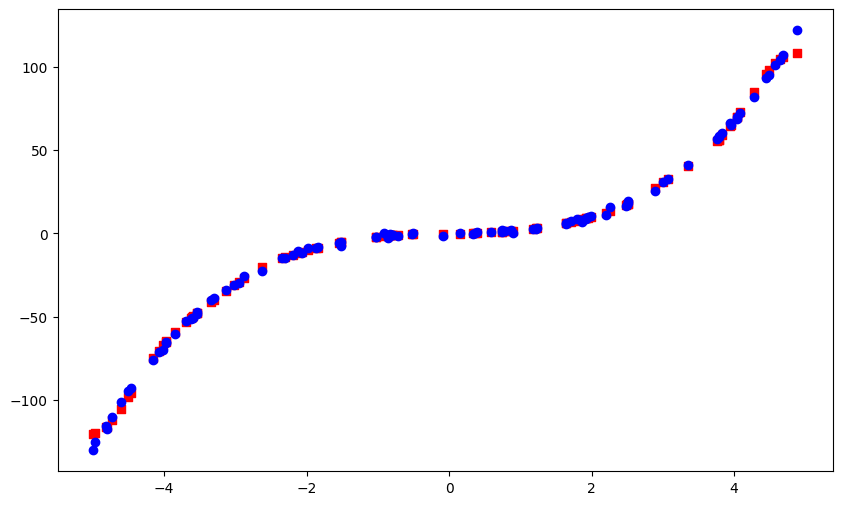

In [30]:
y_hat = output[:, 1].cpu().detach().numpy()
plt.figure(figsize=(10, 6))  # Optional: specifies the figure size
plt.scatter(x, y_hat, label='y2', color='red', marker='s') 
plt.scatter(x, y, label='y1', color='blue', marker='o')  # Plot x vs. y1

In [31]:
np.random.seed(2)
x = np.random.normal(0, 1, 100) 

np.random.seed(24)
epsilon = np.random.normal(0, 0.01, 100) 


y = [(np.sin(x) + epsilon) *10 for x, epsilon in zip(x, epsilon)]
y = np.array(y)


In [32]:
X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]

X = torch.tensor(X, dtype=torch.float64)
eq_model = DagmaRKHS(n, d, "gaussian")
eq_model.to(device)

model = DagmaRKHS_nonlinear(eq_model)
W_est, output = model.fit(X, lambda1=0.01, tau=0.01)
print(W_est)


  0%|          | 0/23000.0 [00:00<?, ?it/s]

squared loss:  tensor(21.3207, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0., device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(2.1321, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(19.8340, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0005, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(1.9839, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(18.4168, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0057, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(1.8474, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(17.0811, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0116, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(1.7197, device='cuda:0', grad_fn=<AddBackward0>)
squared loss:  tensor(15.8244, device='cuda:0', grad_fn=<AddBackward0>)
mu:  0.1
h_val:  tensor(0.0137, device='cuda:0', grad_fn=<AddBackward0>)
obj:  tensor(1.5961, device='cu

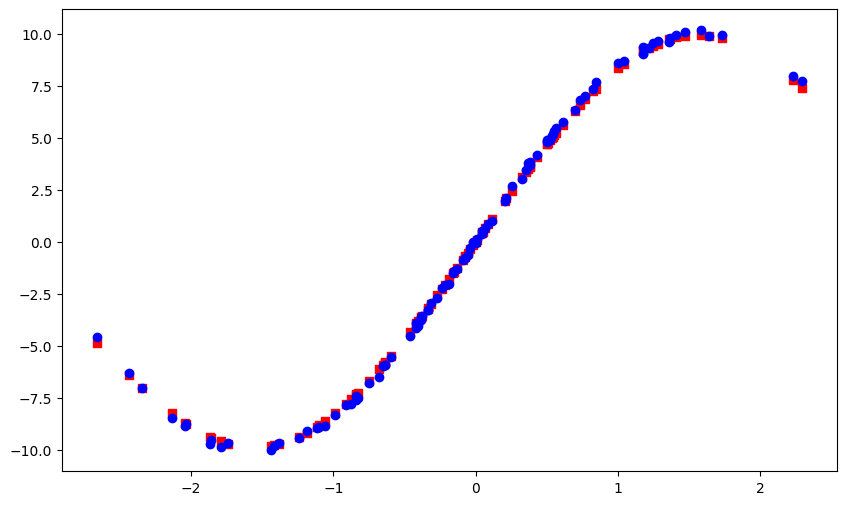

In [33]:
y_hat = output[:, 1].cpu().detach().numpy()
plt.figure(figsize=(10, 6))  # Optional: specifies the figure size
plt.scatter(x, y_hat, label='y2', color='red', marker='s') 
plt.scatter(x, y, label='y1', color='blue', marker='o')  # Plot x vs. y1

### Improvement 

Standardize the data --> worse result
plot loss wrt rho and alpha in log scale (contour loss) in P29
add linear combination of the kernel to the representer Theorem (Proof it by paper prop 3 and 4)
Try real L2 measure
18.02 10:00 meeting
plot y wrt x and f_hat(x) wrt x for tubing data

1) Find best scaler wrt x
2) Do multiple times scaler
3) Do refinement above